# Steady vs. Sweeping Pitch of Vowels Experiment

In this section, we explore the impact of sweeping pitch on the performance of models in speaker recognition task.

## Literature Review:

On phone conversations, we usually try to over articulate to increase the recognizability of our voices to the receiver. One way to reveal our anatomic individuality is to vary our pitch to convey information about our vocal identity. Accordingly, it is hypothesized that sweeping harmonics might maximize speaker-related information more than steady-state pitch. An interesting application for sweeping harmonics would be infant-directed speech (IDS). IDS shows higher acoustic variability compared to adult-directed speech (ADS). Recent work by [Kathiresan et al. (2022)](https://papers.ssrn.com/sol3/papers.cfm?abstract_id=4088888) suggest that the origin of IDS might be an evolutionary outcome of signalling caregivers' vocal identity to their offsprings.

Thus, in this section, we explore the contribution of sweeping harmonics/pitch on speaker identity compared steady-state pitch in self-supervised models.

### Research Questions:

1. Can models predict speaker identity better in case of sweeping harmonics compared to steady-state?
2. Which models are invariant to such vocal timbre variabilities?

## Dataset Description:

For this experiment, we used **SweepingVowels** dataset compiled at UZH. This dataset contains *2010* utterances from *15* Swiss German speakers (11F/4M). Each speaker produced *80* read utterances for training and *54* vowel utterances for testing.

The vowel utterances are divided into 6 pitch conditions (Steady-state: low, mid and high pitch & Sweeping: fall, fall-rise and rise). Each condition is used for 3 vowels (/a/, /i/ and /u/). Finally each condition and vowel is repeated 3 times. Hence, the *54* vowel utterances per speaker.

## 1) Loading Data

In [199]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import deciphering_enigma
import matplotlib.pyplot as plt

#define the experiment config file path
path_to_config = './config.yaml'

#read the experiment config file
exp_config = deciphering_enigma.load_yaml_config(path_to_config)

#register experiment directory and read wav files' paths
audio_files = deciphering_enigma.build_experiment(exp_config)
audio_files = [s for s in audio_files if s.split('/')[-2] != 'test_fullLength']
print(f'Dataset has {len(audio_files)} samples')

Dataset has 2010 samples


In [200]:
def parse_labels(file_path):
    if file_path.split('/')[-2] == 'test_trimmed':
        name = os.path.basename(file_path)
        return name[6:16]
    else:
        return 'train'

def parse_vowels(file_path):
    if file_path.split('/')[-2] == 'test_trimmed':
        name = os.path.basename(file_path)
        return name[4]
    else:
        return '_'

In [201]:
#extract metadata from file name convention
metadata_df = pd.DataFrame()
metadata_df['Audio_name'] = audio_files
metadata_df['ID'] = np.array(list(map(lambda x: os.path.basename(x).split('_')[0][:2], audio_files)))
metadata_df['Gender'] = np.array(list(map(lambda x: os.path.basename(x).split('_')[0][-1], audio_files)))
metadata_df['Vowel'] = np.array(list(map(lambda x: parse_vowels(x), audio_files)))
metadata_df['Label'] = np.array(list(map(lambda x: parse_labels(x), audio_files)))

#load audio files as torch tensors to get ready for feature extraction
audio_tensor_list = deciphering_enigma.load_dataset(audio_files, cfg=exp_config, speaker_ids=metadata_df['ID'], audio_format='wav')

Audio Tensors are already saved for sweeping_pitch_experiment


## 2) Generating Embeddings

We are generating speech embeddings from 16 different models (Log-Mel-Spectrogram, Cochleagram, openSMILE, BYOL-A/CNN, BYOL-I/CNN, BYOL-S/CNN, BYOL-S/CvT, Hybrid BYOL-S/CvT, TERA, APC, Wav2Vec2/latent, Wav2Vec2/contextual, HuBERT/latent, HuBERT/contextual, Data2Vec/latent and Data2Vec/contextual).

In [202]:
#generate speech embeddings
feature_extractor = deciphering_enigma.FeatureExtractor()
embeddings_dict = feature_extractor.extract(audio_tensor_list, exp_config)

Load Log-Mel-Spectrogram Model
Log-Mel-Spectrogram embeddings are already saved for sweeping_pitch_experiment
(2010, 128)
Load Cochleagram Model
Cochleagram embeddings are already saved for sweeping_pitch_experiment
(2010, 85)
Load openSMILE_eGeMAPS Model
openSMILE_eGeMAPS embeddings are already saved for sweeping_pitch_experiment
(2010, 88)
Load openSMILE_ComParE Model
openSMILE_ComParE embeddings are already saved for sweeping_pitch_experiment
(2010, 6373)
Load BYOL-A_default Model
BYOL-A_default embeddings are already saved for sweeping_pitch_experiment
(2010, 2048)
Load BYOL-S_default Model
BYOL-S_default embeddings are already saved for sweeping_pitch_experiment
(2010, 2048)
Load BYOL-I_default Model
BYOL-I_default embeddings are already saved for sweeping_pitch_experiment
(2010, 2048)
Load BYOL-S_cvt Model
BYOL-S_cvt embeddings are already saved for sweeping_pitch_experiment
(2010, 2048)
Load Hybrid_BYOL-S_cvt Model
Hybrid_BYOL-S_cvt embeddings are already saved for sweeping_pitc

In [204]:
import matplotlib
from pylab import cm
import matplotlib as mpl
matplotlib.font_manager._fmcache
matplotlib.font_manager._rebuild()
mpl.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['axes.linewidth'] = 3

## 3) Linear Encoding:

In this section, we evaluate the predictive power of all models to recognize speakers from sweeping and steady pitch utterances. We used different ML classifiers such as Logistic Regression (LR), Random Forest (RF), Support Vector Machine (SVM) and a shallow linear layer. The work flow of this section, for each model, is as follows:
1) Use the read scentences utterances as training data and the vowel utterances as the test set.
2) The classifier will be trained on the extracted embeddings/features from read scentences for each speaker.
3) Then tested on the extracted embeddings/features from vowel utterances (6 pitch conditions) for each speaker.
4) For each classifier, we implement grid search across its hyperparameters and we report performance for each hyperparameters sequence on the test set
5) We used Predefined splits for train and test.
6) The pipeline comprises standardizing the representations then passing it to the classifier.
7) Consequently, the encoder yields several UAR scores for each classifier, each label and eventually each model.

In [206]:
ml_encoder = ML_Encoder()
for i, (model_name, embeddings) in enumerate(embeddings_dict.items()):
    ml_encoder.run(model_name, embeddings, metadata_df['Label'], metadata_df['ID'], exp_config.dataset_name, 'train')

Linear Encoding Scores are already saved for Log-Mel-Spectrogram model!
Linear Encoding Scores are already saved for Cochleagram model!
Linear Encoding Scores are already saved for openSMILE_eGeMAPS model!
Linear Encoding Scores are already saved for openSMILE_ComParE model!
Linear Encoding Scores are already saved for BYOL-A_default model!
Linear Encoding Scores are already saved for BYOL-S_default model!
Linear Encoding Scores are already saved for BYOL-I_default model!
Linear Encoding Scores are already saved for BYOL-S_cvt model!
Linear Encoding Scores are already saved for Hybrid_BYOL-S_cvt model!
Linear Encoding Scores are already saved for TERA model!
Linear Encoding Scores are already saved for APC model!
Linear Encoding Scores are already saved for Wav2Vec2_latent model!
Linear Encoding Scores are already saved for Wav2Vec2 model!
Linear Encoding Scores are already saved for HuBERT_latent model!
Linear Encoding Scores are already saved for HuBERT model!
Linear Encoding Scores 

In [27]:
#read scores from all models across all classifiers as dataframe
df = pd.read_csv(f'../{exp_config.dataset_name}/linear_encoding_all_models_scores.csv', index_col=0)

### 3.2.1. Logistic Regression

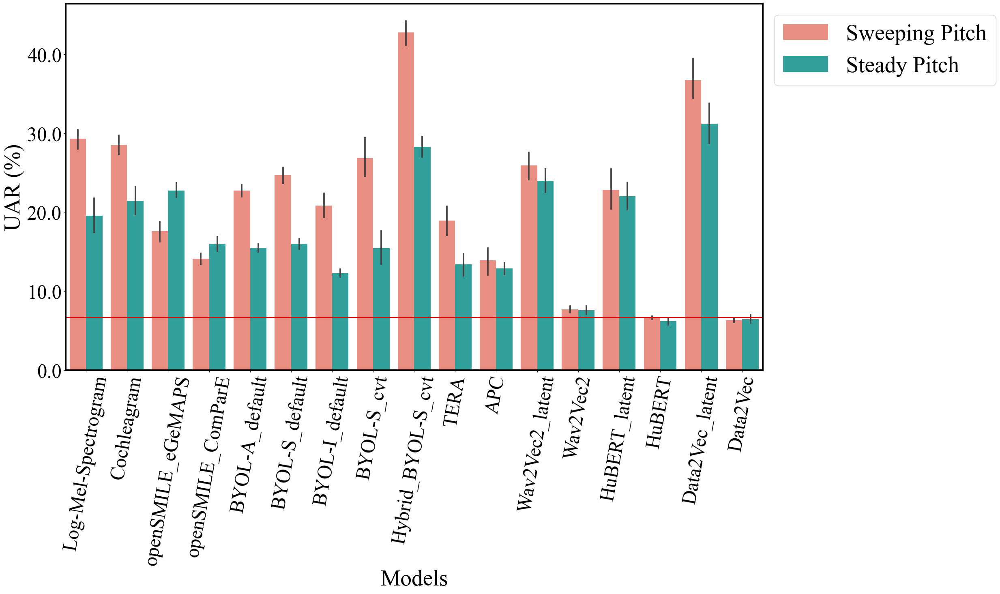

In [36]:
clf = 'LR'
fig, ax = plt.subplots(1, 1, figsize=(25, 15))
palette = {'Sweeping Pitch':'salmon', 'Steady Pitch':'lightseagreen'}
graph = sns.barplot(data=df.loc[df.Clf == clf], x='Model', y='Score', hue='Binary_Label', ax=ax, palette=palette)
ax.set_xticklabels(ax.get_xticklabels(), size = 35, rotation=80)
ax.set_yticklabels(ax.get_yticks(), size = 35)
ax.set_ylabel('UAR (%)', fontsize=40)
ax.set_xlabel('Models', fontsize=40)
ax.axhline(y=6.67, c='red')
ax.legend(bbox_to_anchor=(1, 1), fontsize=40)
plt.tight_layout()
plt.savefig(f'../{exp_config.dataset_name}/linear_encoding_plots/linear_encoding_{clf}.svg')

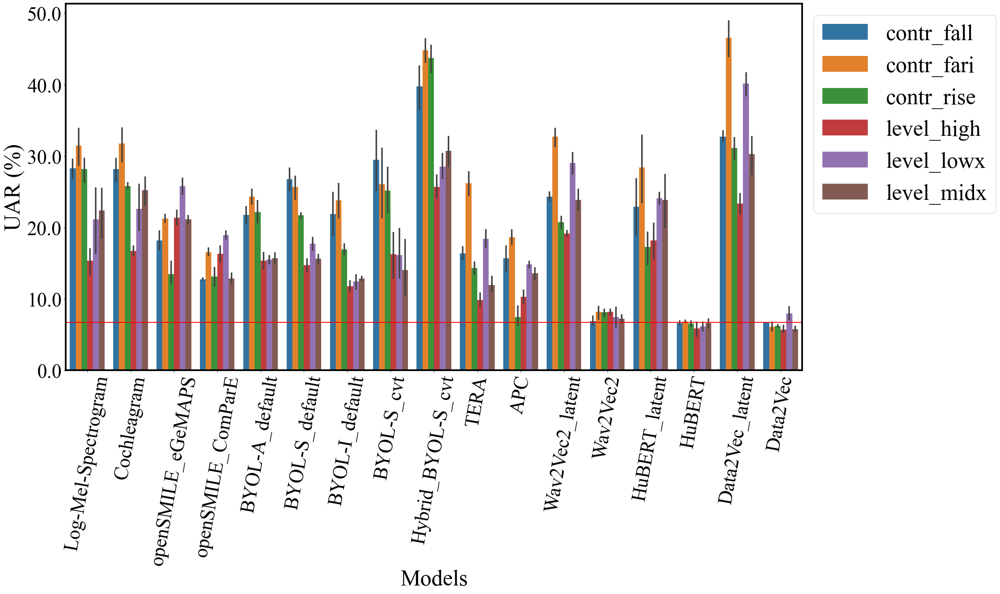

In [37]:
clf = 'LR'
fig, ax = plt.subplots(1, 1, figsize=(25, 15))
graph = sns.barplot(data=df.loc[df.Clf == clf], x='Model', y='Score', hue='Label', ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), size = 35, rotation=80)
ax.set_yticklabels(ax.get_yticks(), size = 35)
ax.set_ylabel('UAR (%)', fontsize=40)
ax.set_xlabel('Models', fontsize=40)
ax.axhline(y=6.67, c='red')
ax.legend(bbox_to_anchor=(1, 1), fontsize=40)
plt.tight_layout()
plt.savefig(f'../{exp_config.dataset_name}/linear_encoding_plots/linear_encoding_alllabels_{clf}.svg')

### 3.2.2. Random Forest

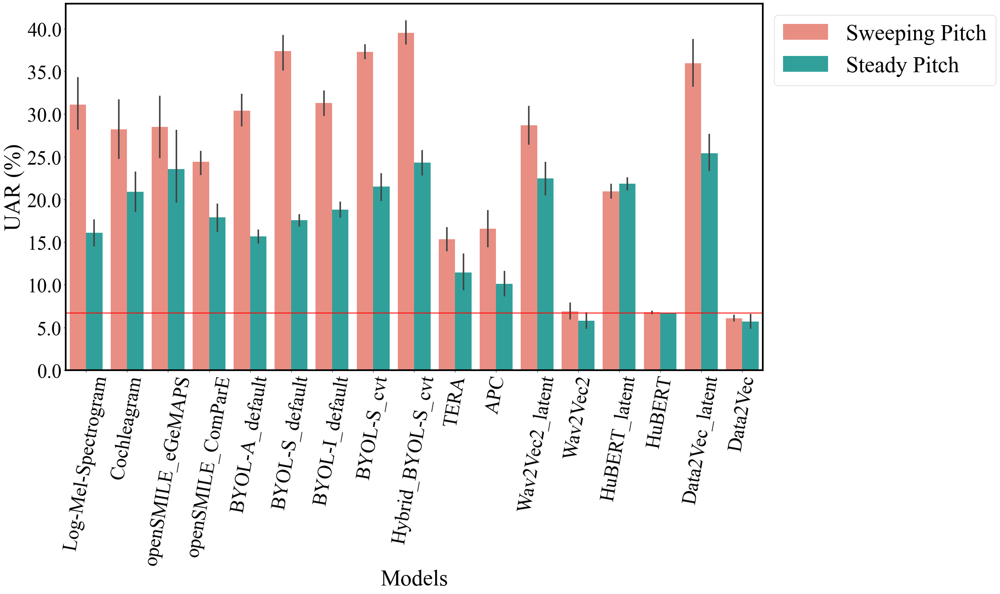

In [38]:
clf = 'RF'
fig, ax = plt.subplots(1, 1, figsize=(25, 15))
palette = {'Sweeping Pitch':'salmon', 'Steady Pitch':'lightseagreen'}
graph = sns.barplot(data=df.loc[df.Clf == clf], x='Model', y='Score', hue='Binary_Label', ax=ax, palette=palette)
ax.set_xticklabels(ax.get_xticklabels(), size = 35, rotation=80)
ax.set_yticklabels(ax.get_yticks(), size = 35)
ax.set_ylabel('UAR (%)', fontsize=40)
ax.set_xlabel('Models', fontsize=40)
ax.axhline(y=6.67, c='red')
ax.legend(bbox_to_anchor=(1, 1), fontsize=40)
plt.tight_layout()
plt.savefig(f'../{exp_config.dataset_name}/linear_encoding_plots/linear_encoding_{clf}.svg')

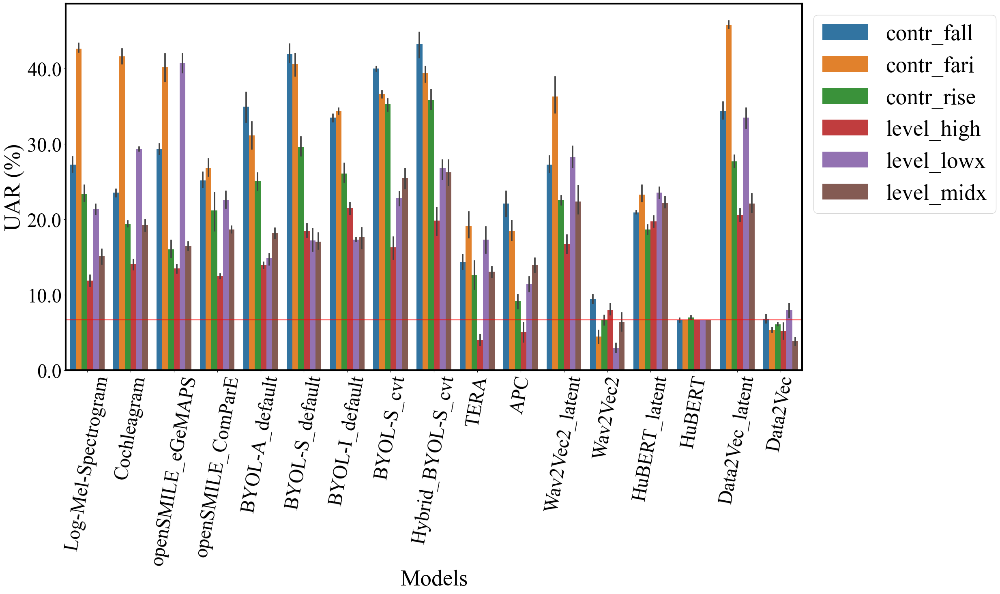

In [39]:
clf = 'RF'
fig, ax = plt.subplots(1, 1, figsize=(25, 15))
graph = sns.barplot(data=df.loc[df.Clf == clf], x='Model', y='Score', hue='Label', ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), size = 35, rotation=80)
ax.set_yticklabels(ax.get_yticks(), size = 35)
ax.set_ylabel('UAR (%)', fontsize=40)
ax.set_xlabel('Models', fontsize=40)
ax.axhline(y=6.67, c='red')
ax.legend(bbox_to_anchor=(1, 1), fontsize=40)
plt.tight_layout()
plt.savefig(f'../{exp_config.dataset_name}/linear_encoding_plots/linear_encoding_alllabels_{clf}.svg')

### 3.2.3. Support Vector Machine

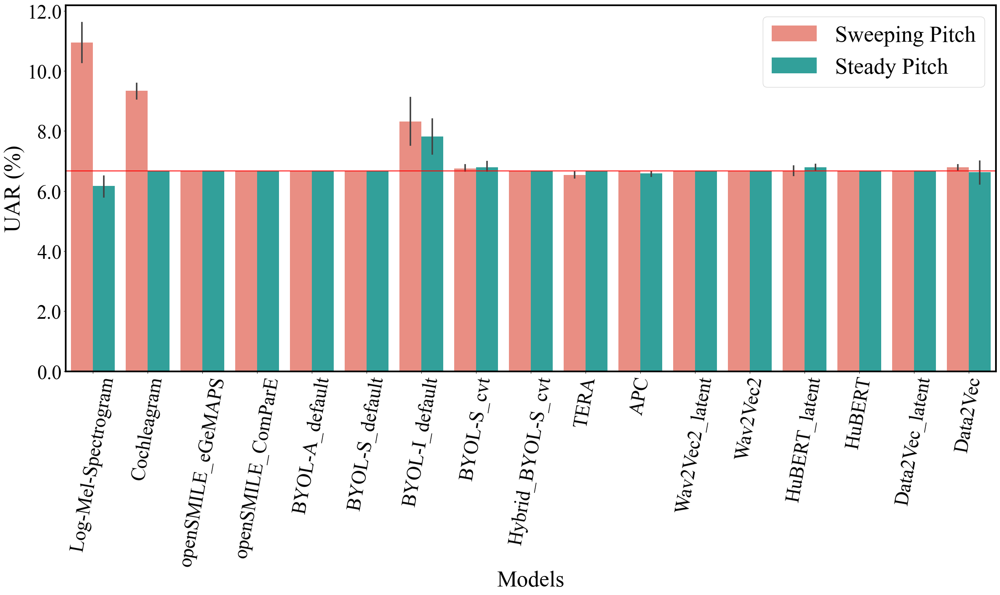

In [40]:
clf = 'SVM'
fig, ax = plt.subplots(1, 1, figsize=(25, 15))
palette = {'Sweeping Pitch':'salmon', 'Steady Pitch':'lightseagreen'}
graph = sns.barplot(data=df.loc[df.Clf == clf], x='Model', y='Score', hue='Binary_Label', ax=ax, palette=palette)
ax.set_xticklabels(ax.get_xticklabels(), size = 35, rotation=80)
ax.set_yticklabels(ax.get_yticks(), size = 35)
ax.set_ylabel('UAR (%)', fontsize=40)
ax.set_xlabel('Models', fontsize=40)
ax.axhline(y=6.67, c='red')
ax.legend(bbox_to_anchor=(1, 1), fontsize=40)
plt.tight_layout()
plt.savefig(f'../{exp_config.dataset_name}/linear_encoding_plots/linear_encoding_{clf}.svg')

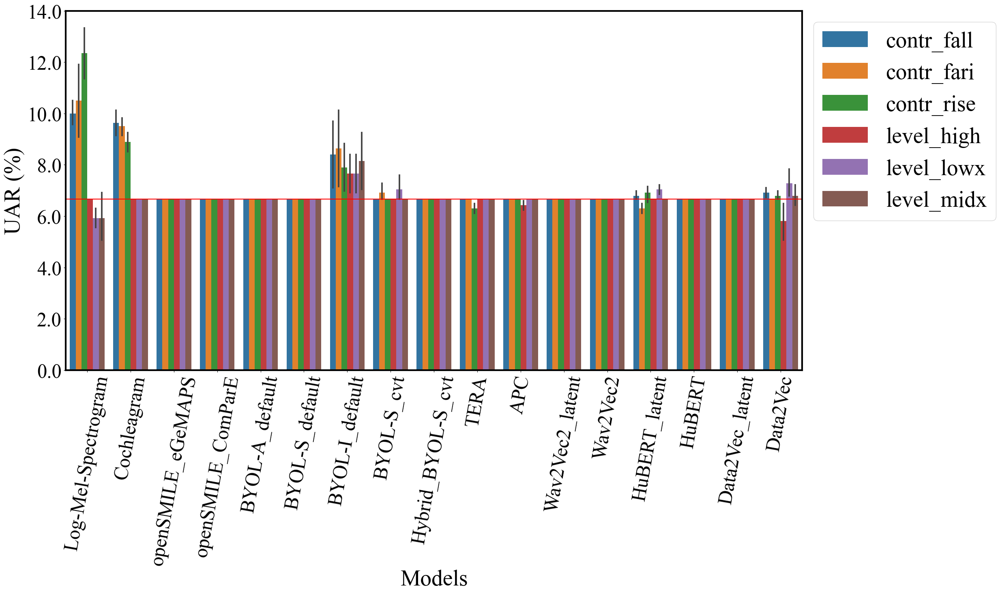

In [41]:
clf = 'SVM'
fig, ax = plt.subplots(1, 1, figsize=(25, 15))
graph = sns.barplot(data=df.loc[df.Clf == clf], x='Model', y='Score', hue='Label', ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), size = 35, rotation=80)
ax.set_yticklabels(ax.get_yticks(), size = 35)
ax.set_ylabel('UAR (%)', fontsize=40)
ax.set_xlabel('Models', fontsize=40)
ax.axhline(y=6.67, c='red')
ax.legend(bbox_to_anchor=(1, 1), fontsize=40)
plt.tight_layout()
plt.savefig(f'../{exp_config.dataset_name}/linear_encoding_plots/linear_encoding_alllabels_{clf}.svg')

### 3.2.4. MLP

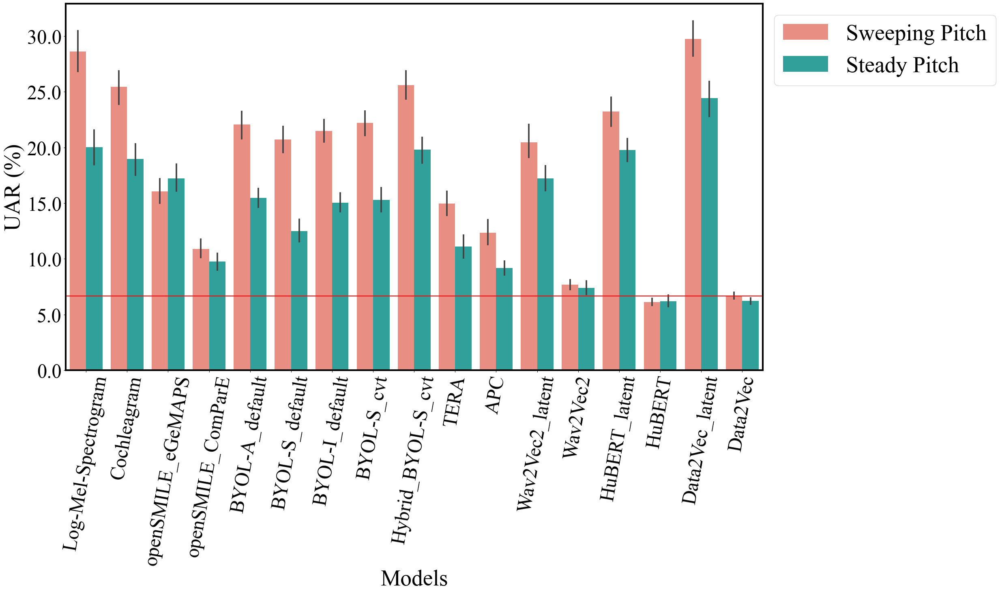

In [42]:
clf = 'MLP'
fig, ax = plt.subplots(1, 1, figsize=(25, 15))
palette = {'Sweeping Pitch':'salmon', 'Steady Pitch':'lightseagreen'}
graph = sns.barplot(data=df.loc[df.Clf == clf], x='Model', y='Score', hue='Binary_Label', ax=ax, palette=palette)
ax.set_xticklabels(ax.get_xticklabels(), size = 35, rotation=80)
ax.set_yticklabels(ax.get_yticks(), size = 35)
ax.set_ylabel('UAR (%)', fontsize=40)
ax.set_xlabel('Models', fontsize=40)
ax.axhline(y=6.67, c='red')
ax.legend(bbox_to_anchor=(1, 1), fontsize=40)
plt.tight_layout()
plt.savefig(f'../{exp_config.dataset_name}/linear_encoding_plots/linear_encoding_{clf}.svg')

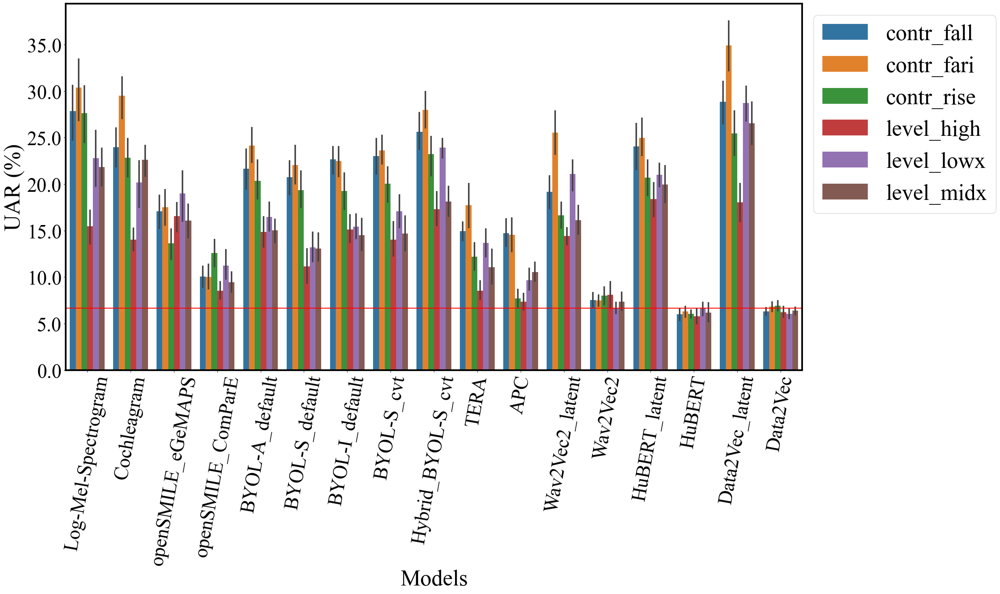

In [43]:
clf = 'MLP'
fig, ax = plt.subplots(1, 1, figsize=(25, 15))
graph = sns.barplot(data=df.loc[df.Clf == clf], x='Model', y='Score', hue='Label', ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), size = 35, rotation=80)
ax.set_yticklabels(ax.get_yticks(), size = 35)
ax.set_ylabel('UAR (%)', fontsize=40)
ax.set_xlabel('Models', fontsize=40)
ax.axhline(y=6.67, c='red')
ax.legend(bbox_to_anchor=(1, 1), fontsize=40)
plt.tight_layout()
plt.savefig(f'../{exp_config.dataset_name}/linear_encoding_plots/linear_encoding_alllabels_{clf}.svg')

## 4) Similarity Representation Analysis:

100%|██████████████████| 17/17 [03:01<00:00, 10.70s/it]


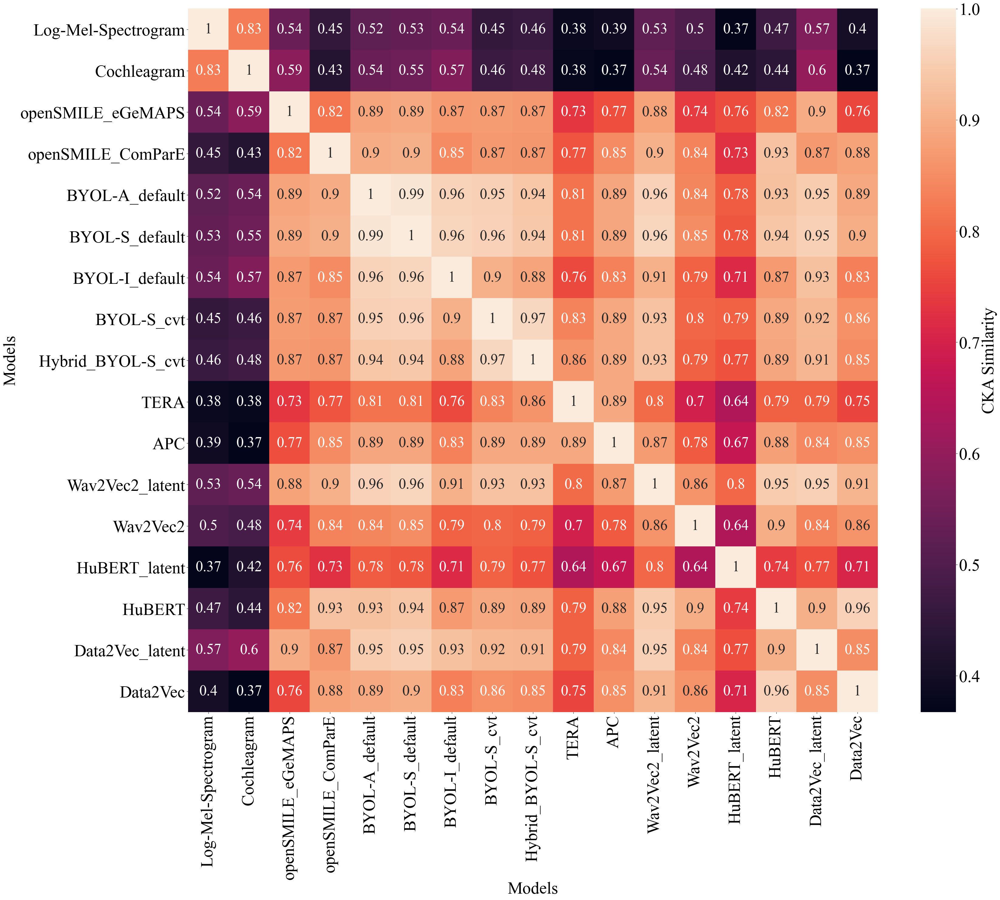

In [45]:
cka_class = deciphering_enigma.CKA(unbiased=True, kernel='rbf', rbf_threshold=0.5)
cka_ = cka_class.run_cka(embeddings_dict, compute_from='features', save_path=f'../{exp_config.dataset_name}/', save_array=True)
cka_class.plot_heatmap(cka_, embeddings_dict.keys(), save_path=f'../{exp_config.dataset_name}/', save_fig=True)

## 5) Dimensionality Reduction

The previous analysis showed how well the model is capable of grouping the uttereances of the same speaker in different cases (scripted and spontaneous) in the embedding space (high dimension). That being said, we will replicate the same analysis but in the lower dimension space to visualize the impact of speaking styles on voice identity perception.

Accordingly, we will utilize different kind of dimensionality reduction such as PCA, tSNE, UMAP and PaCMAP to get a better idea of how the speakers' samples are clustered together in 2D. However, one constraint is that these methods are sensitive to their hyperparameters (except PCA) which could imapct our interpretation of the results. Thus, a grid search across the hyperparameters for each method is implemented.

Another issue would be quantifying the ability of these methods to perserve the distances amongst samples in the high dimension and present it in a lower dimension. To address this, we are using two metrics KNN and CPD that represent the ability of the algorithm to preserve local and global structures of the original embedding space, respectively. Both metrics are adopted from this [paper](https://www.nature.com/articles/s41467-019-13056-x) in which they define both metrics as follows:

* KNN: The fraction of k-nearest neighbours in the original high-dimensional data that are preserved as k-nearest neighbours in the embedding. KNN quantifies preservation of the local, or microscopic structure. The value of K used here is the min number of samples a speaker would have in the original space.

* CPD: Spearman correlation between pairwise distances in the high-dimensional space and in the reduced embedding. CPD quantifies preservation of the global, or macroscropic structure. Computed across all pairs among 1000 randomly chosen points without replacement. 

Consequently, we present the results from dimensionality reduction methods in two ways, one optimimizing local structure metric (KNN) and the other optimizing global structure metric (CPD).

In [208]:
tuner = deciphering_enigma.ReducerTuner()
for i, model_name in enumerate(embeddings_dict.keys()):
    print(f'{model_name}:')
    tuner.tune_reducer(embeddings_dict[model_name], metadata=metadata_df, dataset_name=exp_config.dataset_name, model_name=model_name)

Log-Mel-Spectrogram:
Tuned Reduced Embeddings already saved for Log-Mel-Spectrogram model!
Cochleagram:
Tuned Reduced Embeddings already saved for Cochleagram model!
openSMILE_eGeMAPS:
Tuned Reduced Embeddings already saved for openSMILE_eGeMAPS model!
openSMILE_ComParE:
Tuned Reduced Embeddings already saved for openSMILE_ComParE model!
BYOL-A_default:
Tuned Reduced Embeddings already saved for BYOL-A_default model!
BYOL-S_default:
Tuned Reduced Embeddings already saved for BYOL-S_default model!
BYOL-I_default:
Tuned Reduced Embeddings already saved for BYOL-I_default model!
BYOL-S_cvt:
Tuned Reduced Embeddings already saved for BYOL-S_cvt model!
Hybrid_BYOL-S_cvt:
Tuned Reduced Embeddings already saved for Hybrid_BYOL-S_cvt model!
TERA:
Tuned Reduced Embeddings already saved for TERA model!
APC:
Tuned Reduced Embeddings already saved for APC model!
Wav2Vec2_latent:
Tuned Reduced Embeddings already saved for Wav2Vec2_latent model!
Wav2Vec2:
Tuned Reduced Embeddings already saved for W

In [211]:
handcrafted_features = ['Log-Mel-Spectrogram', 'Cochleagram']
opensmile_features = ['openSMILE_eGeMAPS', 'openSMILE_ComParE']
byol_models = ['BYOL-A_default', 'BYOL-S_default', 'BYOL-I_default']
cvt_models = ['BYOL-S_cvt', 'Hybrid_BYOL-S_cvt']
generative_models = ['TERA', 'APC']
wav2vec2_models = ['Wav2Vec2_latent', 'Wav2Vec2']
hubert_models = ['HuBERT_latent', 'HuBERT']
data2vec_models = ['Data2Vec_latent', 'Data2Vec']

In [210]:
def visualize_embeddings(df, label_name, metrics=[], axis=[], acoustic_param={}, opt_structure='Local', red_name='PCA', row=1, col=1, label='spon'):
    plot = sns.scatterplot(data=df, x=(red_name, opt_structure, 'Dim1'), y=(red_name, opt_structure, 'Dim2'), hue=label_name, palette='deep', style=label_name, ax=axis)
    axis.set(xlabel=None, ylabel=None, xticklabels=[], yticklabels=[])
    axis.tick_params(left=False, bottom=False)
    axis.get_legend().remove()

### 5.1. Mapping Identity

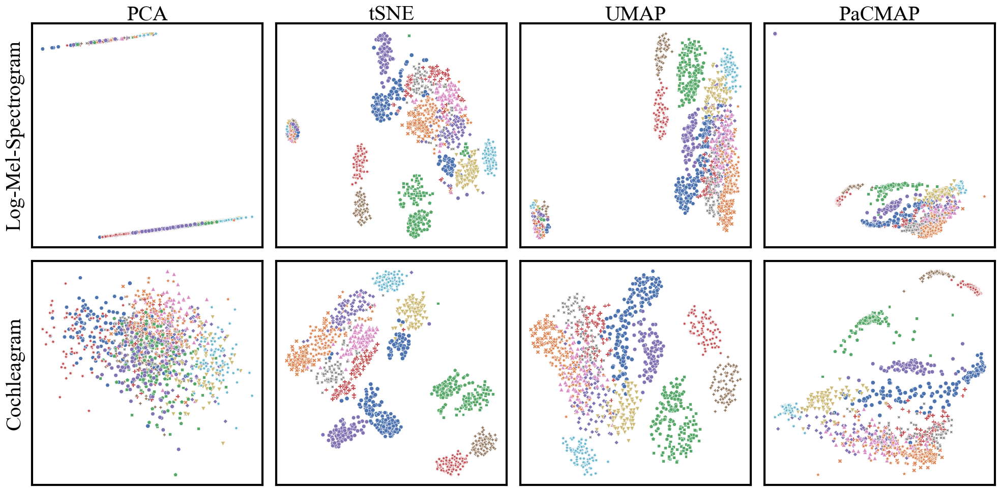

In [106]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'ID'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(handcrafted_features):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label=='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/handcrafted_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/handcrafted_{label}_dimred.svg')

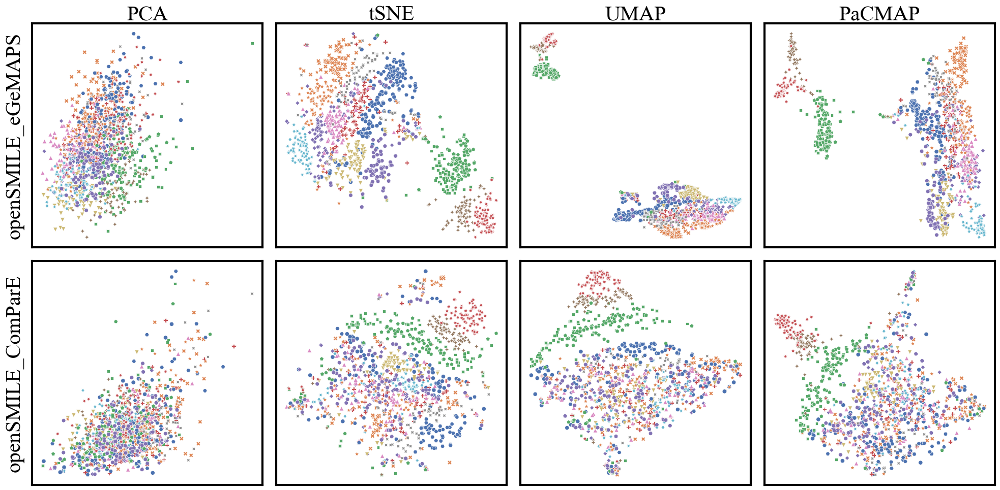

In [212]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'ID'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(opensmile_features):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label=='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/opensmile_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/opensmile_{label}_dimred.svg')

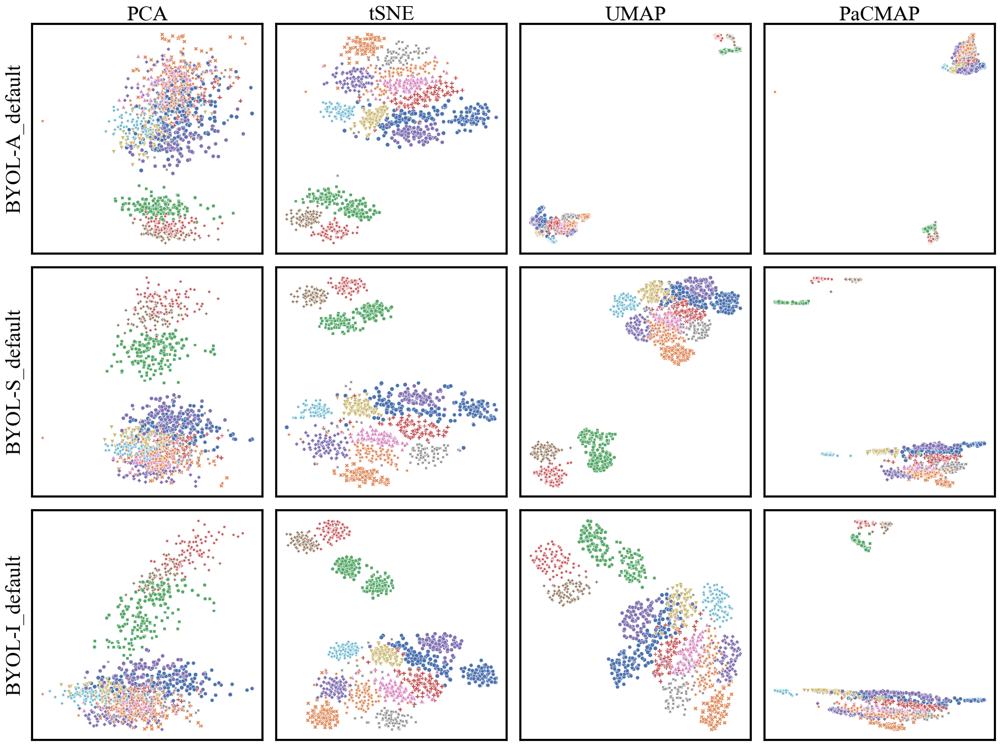

In [107]:
fig, ax = plt.subplots(3, 4, figsize=(20, 15))
optimize = 'Global'
label = 'ID'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(byol_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label=='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/byol_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/byol_{label}_dimred.svg')

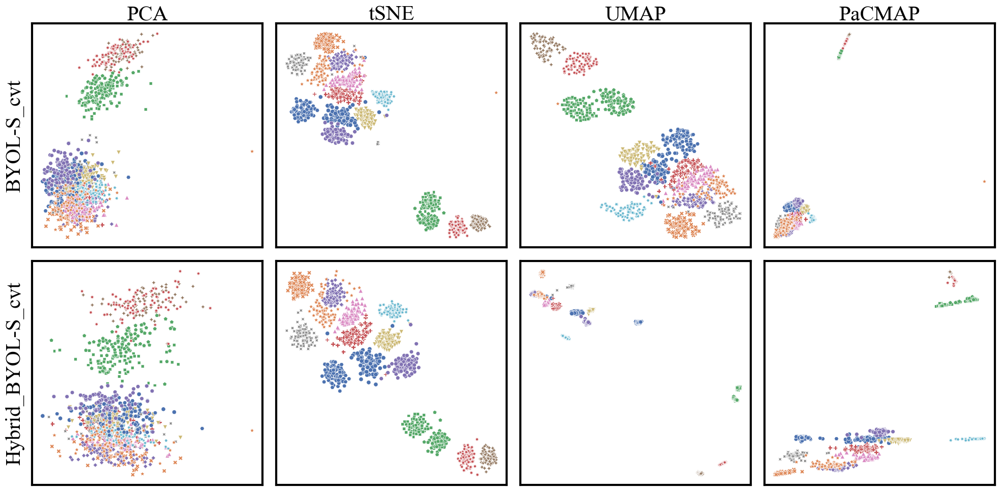

In [108]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'ID'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(cvt_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label=='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/cvt_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/cvt_{label}_dimred.svg')

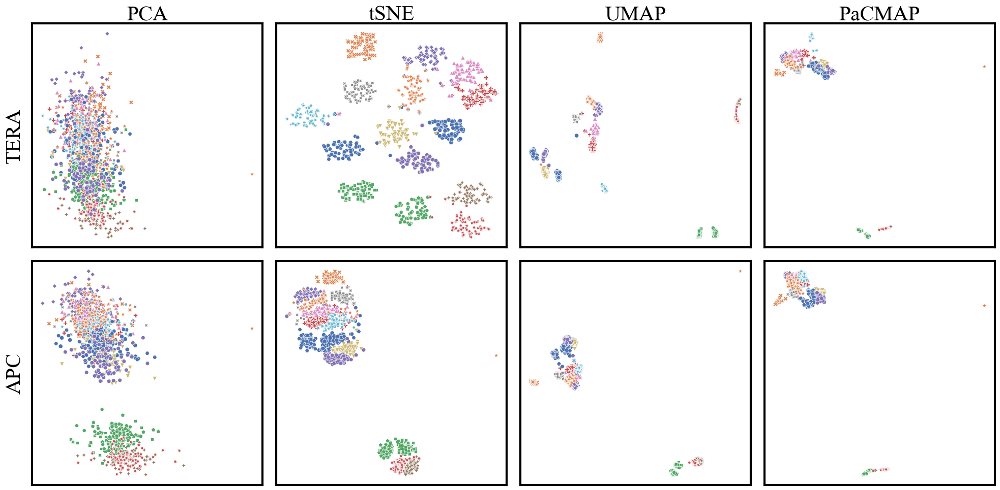

In [111]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'ID'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(generative_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label=='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/generative_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/generative_{label}_dimred.svg')

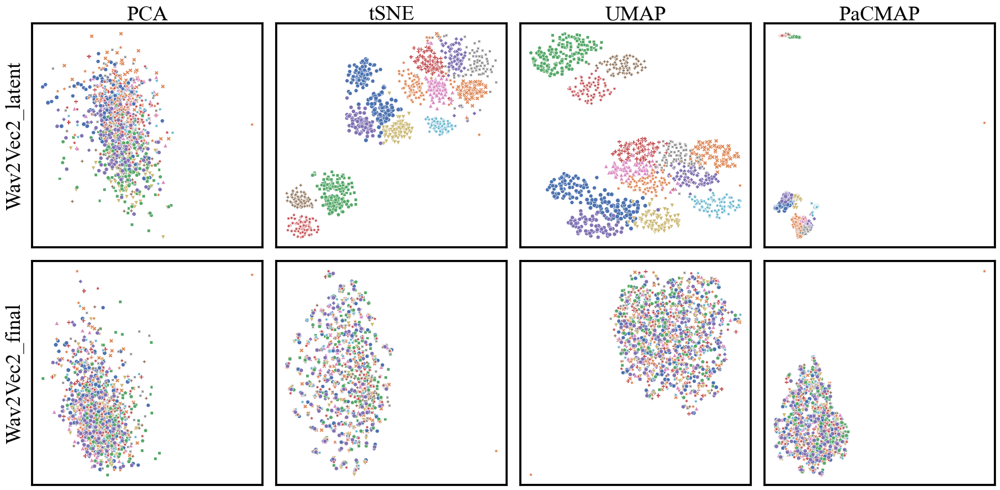

In [115]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'ID'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(wav2vec2_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label=='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    if model_name == 'Wav2Vec2':
        model_name += '_final'
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/wav2vec2_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/wav2vec2_{label}_dimred.svg')

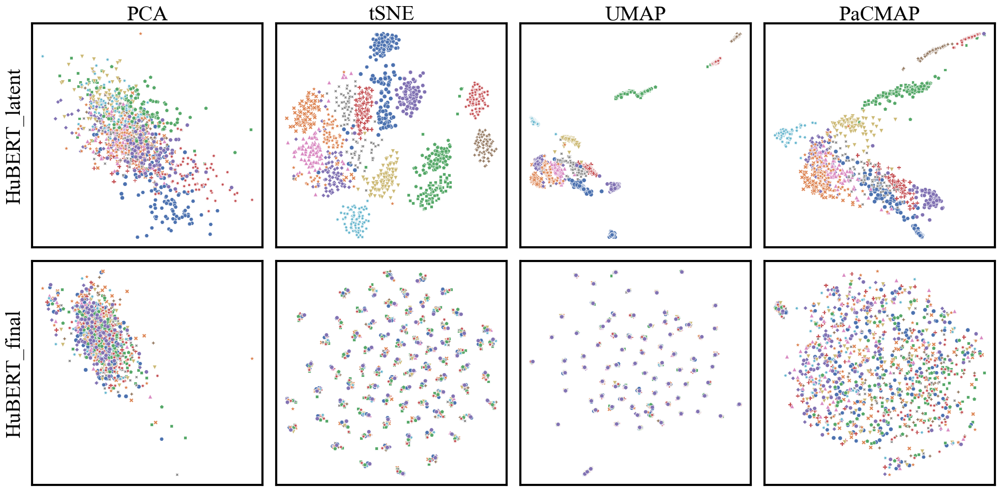

In [116]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'ID'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(hubert_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label=='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    if model_name == 'HuBERT':
        model_name += '_final'
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/hubert_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/hubert_{label}_dimred.svg')

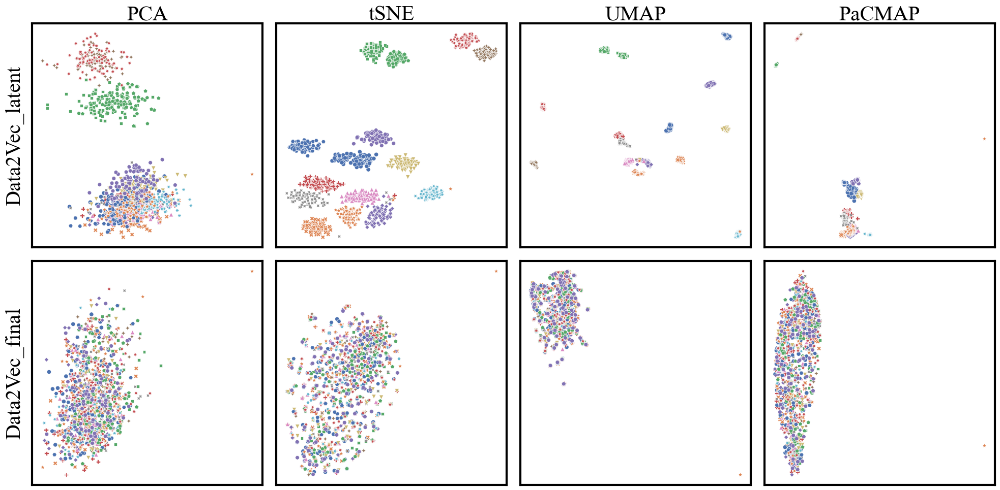

In [117]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'ID'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(data2vec_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label=='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    if model_name == 'Data2Vec':
        model_name += '_final'
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/data2vec_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/data2vec_{label}_dimred.svg')

### 5.2. Mapping Vowels

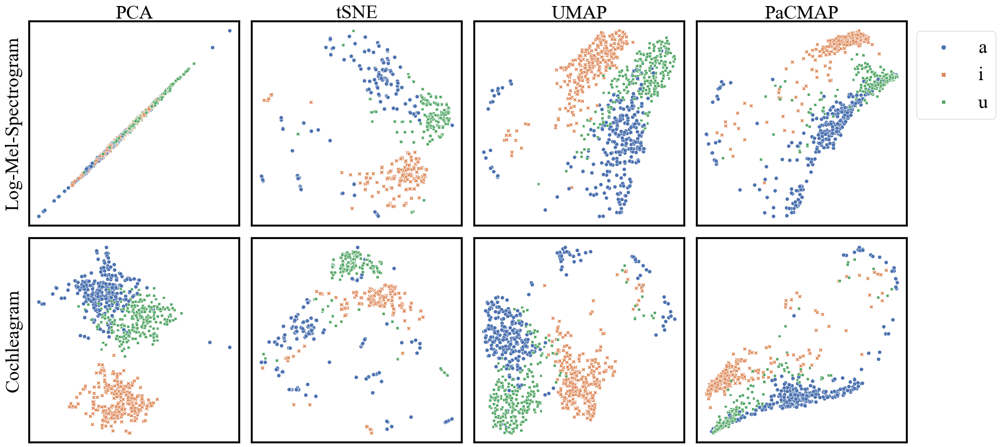

In [119]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Vowel'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(handcrafted_features):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/handcrafted_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/handcrafted_{label}_dimred.svg')

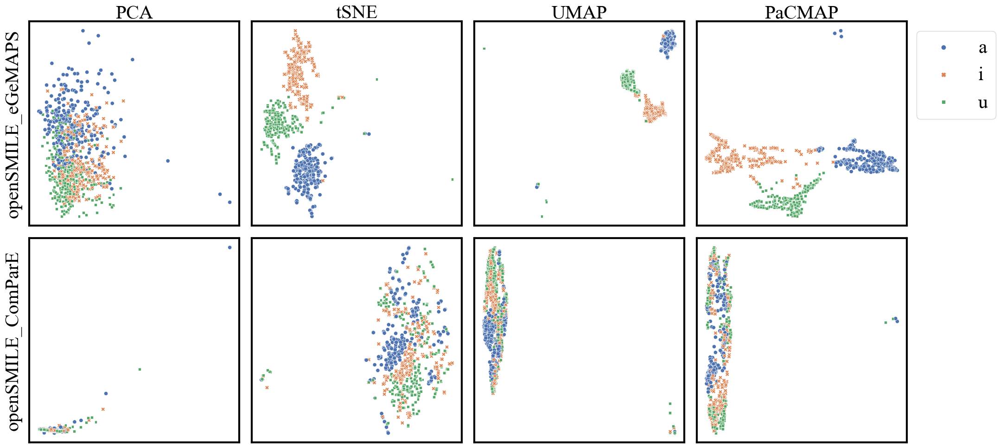

In [215]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Vowel'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(opensmile_features):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/opensmile_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/opensmile_{label}_dimred.svg')

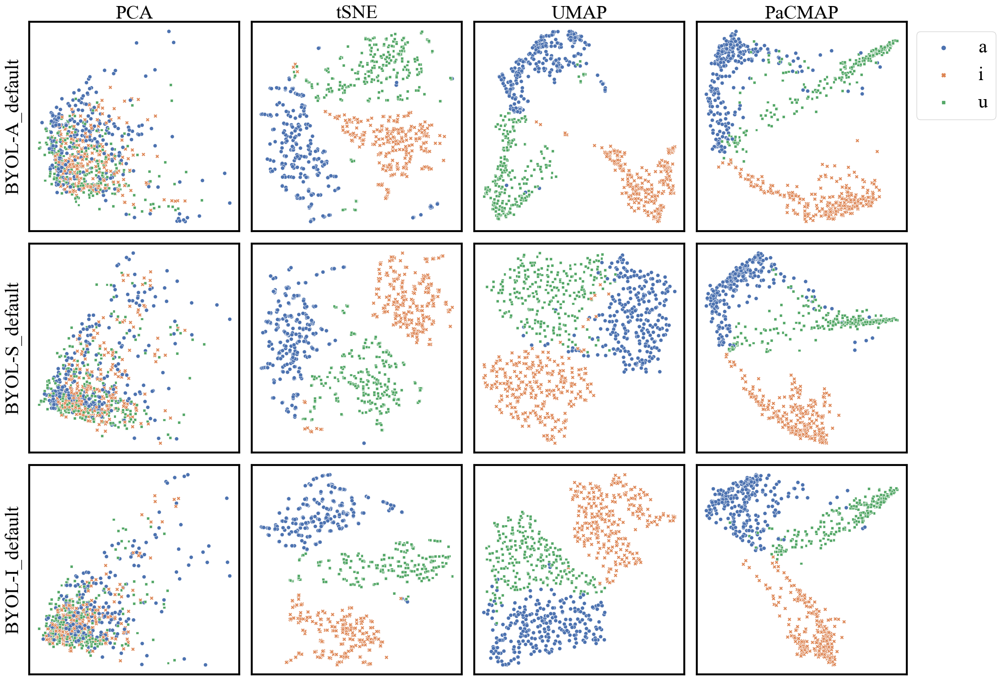

In [213]:
fig, ax = plt.subplots(3, 4, figsize=(20, 15))
optimize = 'Global'
label = 'Vowel'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(byol_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/byol_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/byol_{label}_dimred.svg')

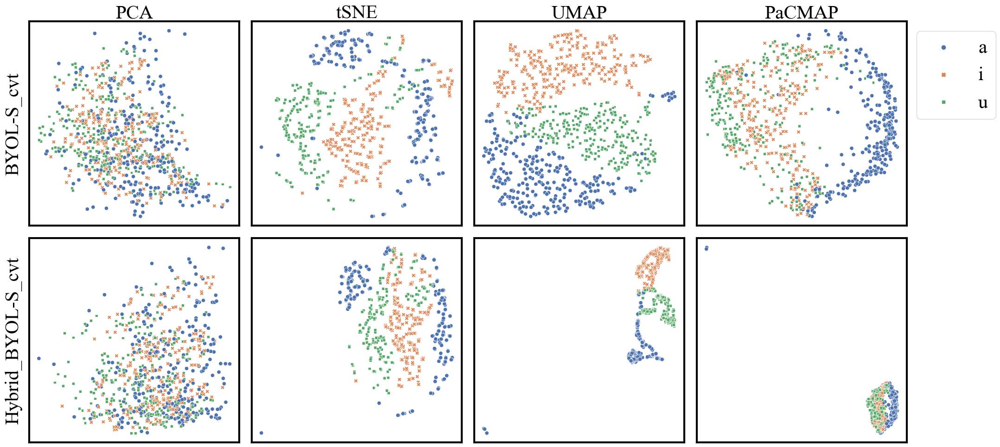

In [124]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Vowel'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(cvt_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/cvt_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/cvt_{label}_dimred.svg')

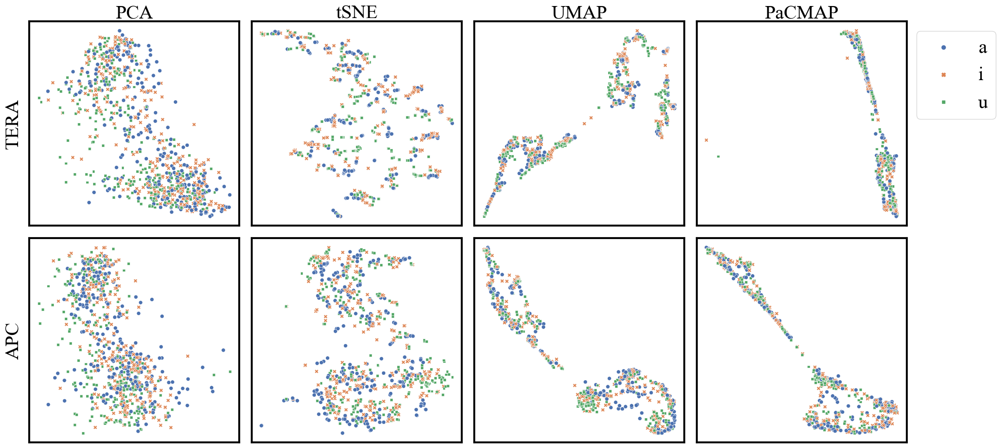

In [125]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Vowel'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(generative_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/generative_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/generative_{label}_dimred.svg')

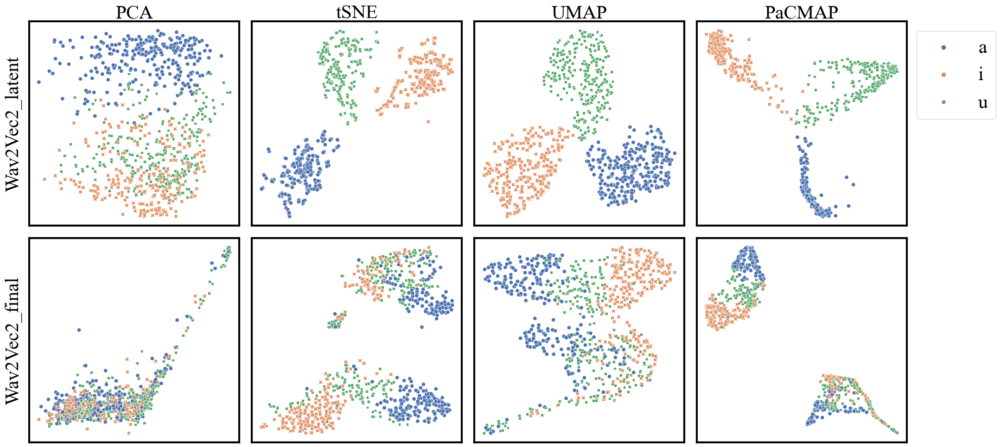

In [126]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Vowel'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(wav2vec2_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    if model_name == 'Wav2Vec2':
        model_name += '_final'
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/wav2vec2_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/wav2vec2_{label}_dimred.svg')

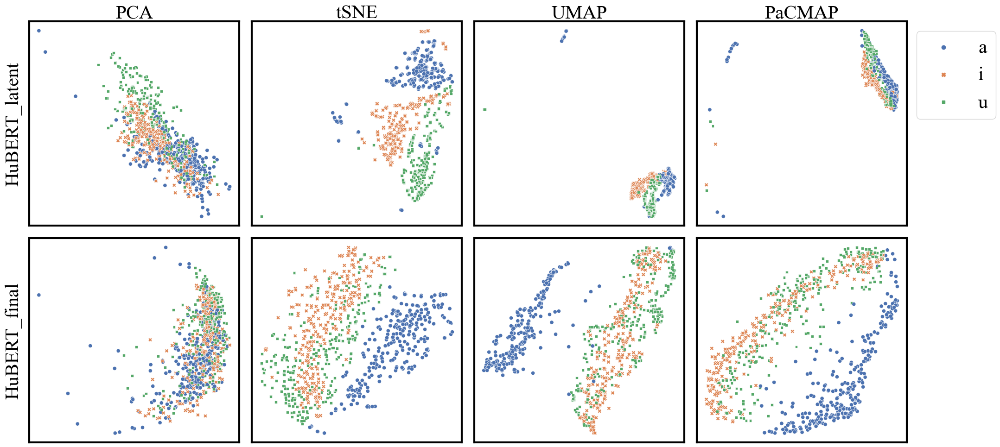

In [127]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Vowel'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(hubert_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    if model_name == 'HuBERT':
        model_name += '_final'
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/hubert_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/hubert_{label}_dimred.svg')

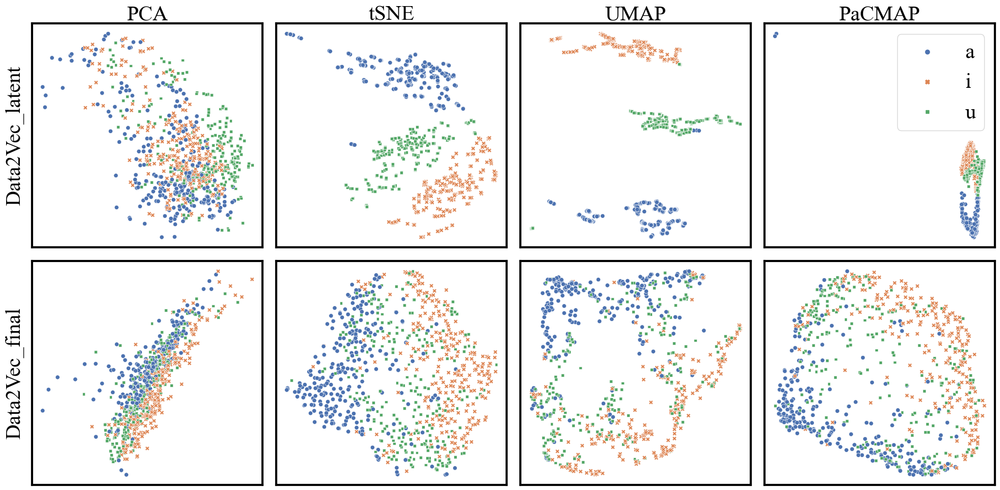

In [128]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Vowel'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(data2vec_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    if model_name == 'Data2Vec':
        model_name += '_final'
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/data2vec_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/data2vec_{label}_dimred.svg')

### 5.3. Mapping Sweeping and Steady Harmonics

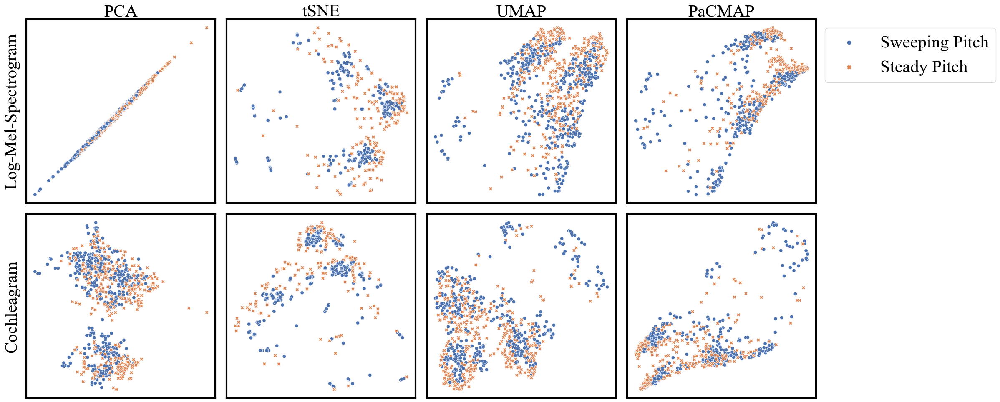

In [140]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Binary_Label'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(handcrafted_features):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    df['Binary_Label'] = df['Label'].apply(lambda x: x[:5])
    df['Binary_Label'] = df['Binary_Label'].str.replace('contr', 'Sweeping Pitch')
    df['Binary_Label'] = df['Binary_Label'].str.replace('level', 'Steady Pitch')
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/handcrafted_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/handcrafted_{label}_dimred.svg')

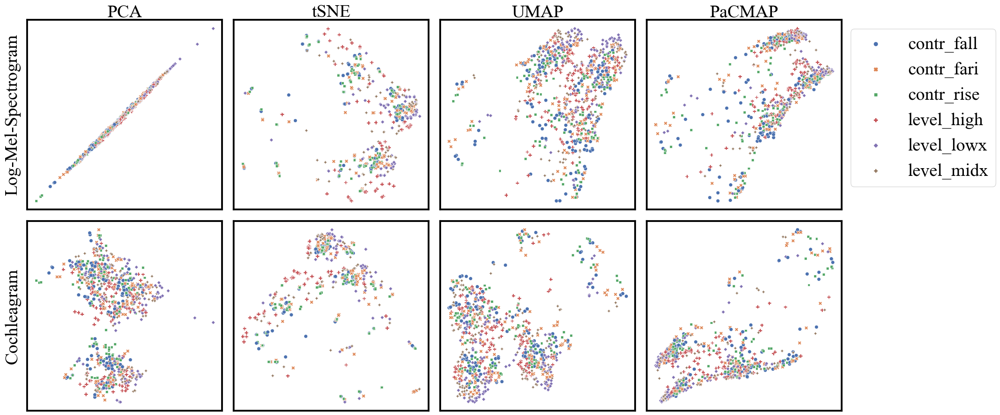

In [141]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Label'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(handcrafted_features):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/handcrafted_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/handcrafted_{label}_dimred.svg')

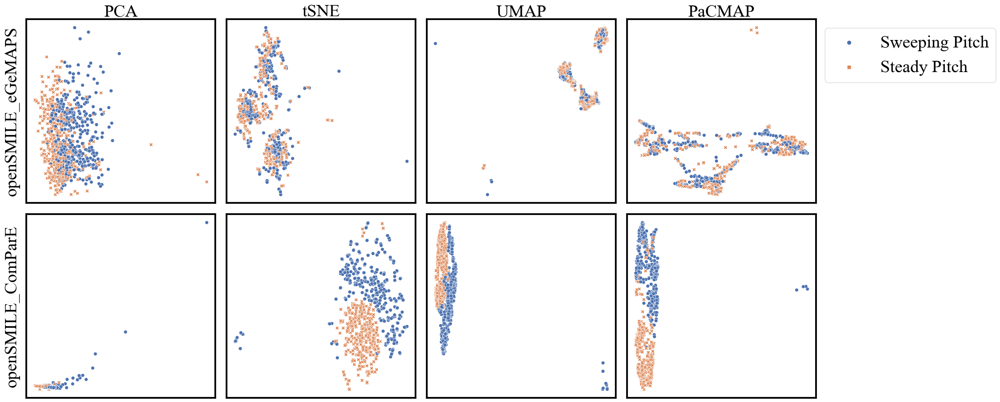

In [216]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Binary_Label'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(opensmile_features):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    df['Binary_Label'] = df['Label'].apply(lambda x: x[:5])
    df['Binary_Label'] = df['Binary_Label'].str.replace('contr', 'Sweeping Pitch')
    df['Binary_Label'] = df['Binary_Label'].str.replace('level', 'Steady Pitch')
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/opensmile_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/opensmile_{label}_dimred.svg')

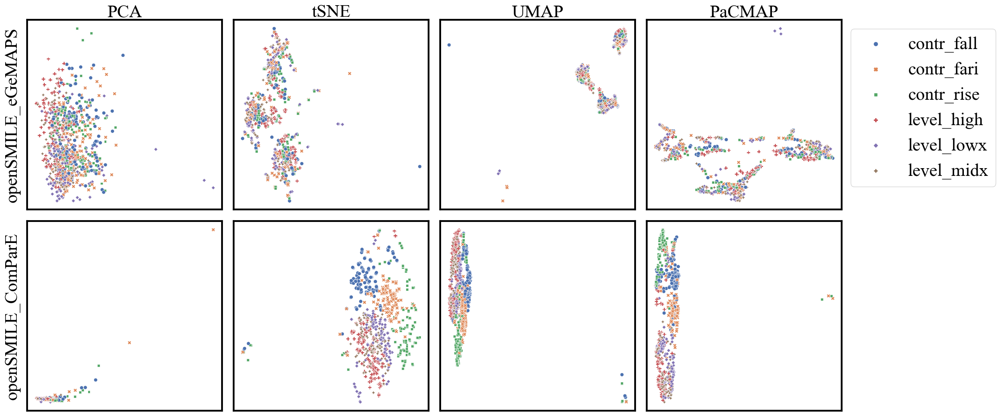

In [217]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Label'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(opensmile_features):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/opensmile_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/opensmile_{label}_dimred.svg')

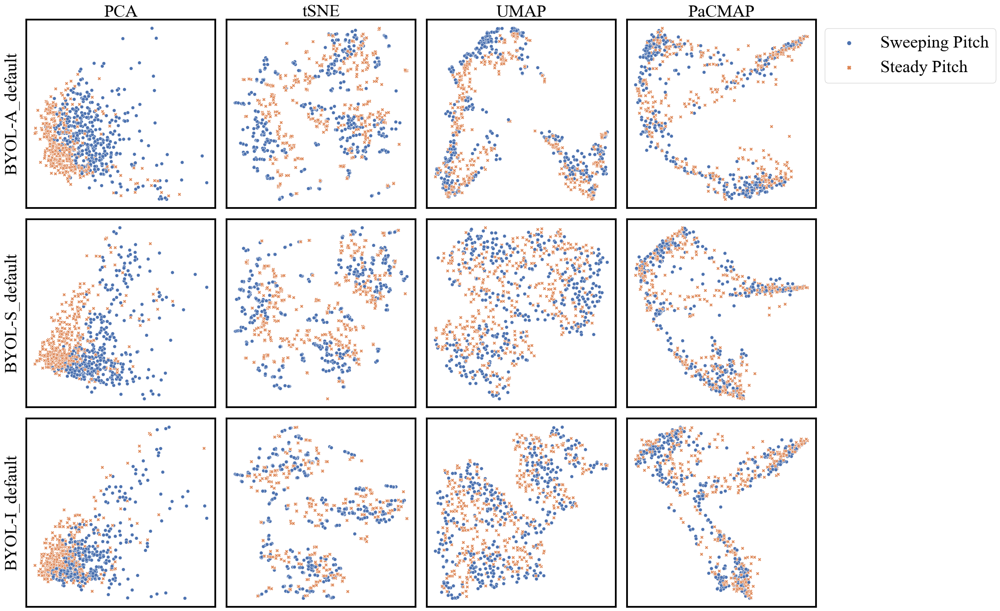

In [143]:
fig, ax = plt.subplots(3, 4, figsize=(20, 15))
optimize = 'Global'
label = 'Binary_Label'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(byol_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    df['Binary_Label'] = df['Label'].apply(lambda x: x[:5])
    df['Binary_Label'] = df['Binary_Label'].str.replace('contr', 'Sweeping Pitch')
    df['Binary_Label'] = df['Binary_Label'].str.replace('level', 'Steady Pitch')
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/byol_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/byol_{label}_dimred.svg')

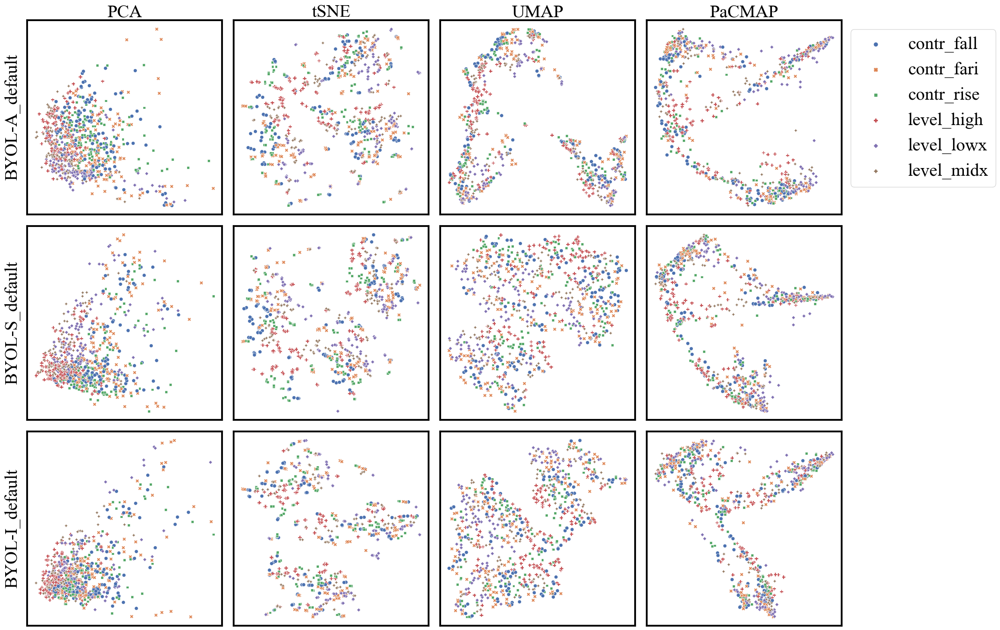

In [144]:
fig, ax = plt.subplots(3, 4, figsize=(20, 15))
optimize = 'Global'
label = 'Label'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(byol_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/byol_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/byol_{label}_dimred.svg')

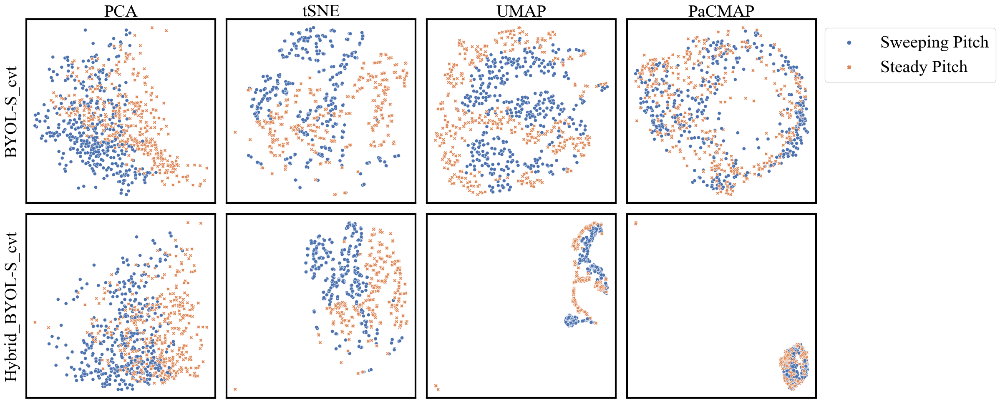

In [146]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Binary_Label'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(cvt_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    df['Binary_Label'] = df['Label'].apply(lambda x: x[:5])
    df['Binary_Label'] = df['Binary_Label'].str.replace('contr', 'Sweeping Pitch')
    df['Binary_Label'] = df['Binary_Label'].str.replace('level', 'Steady Pitch')
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/cvt_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/cvt_{label}_dimred.svg')

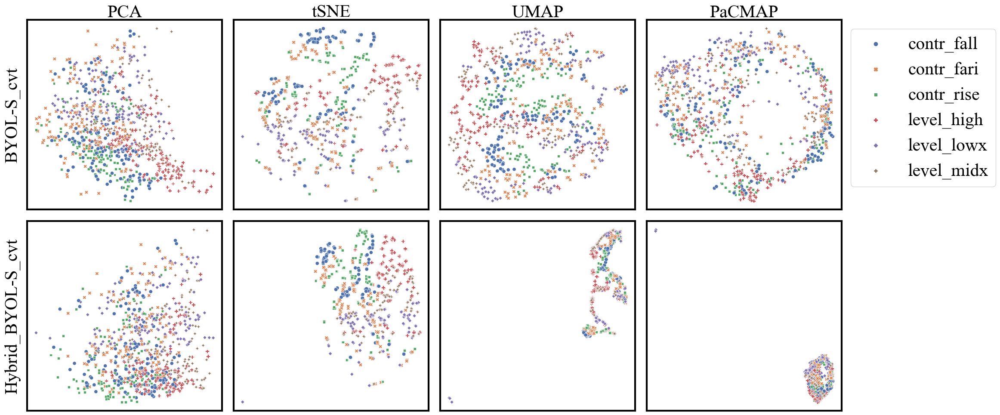

In [148]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Label'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(cvt_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/cvt_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/cvt_{label}_dimred.svg')

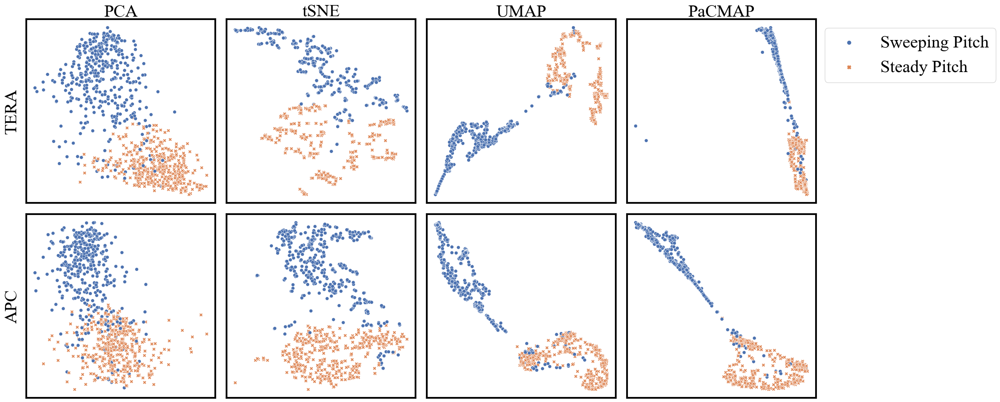

In [150]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Binary_Label'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(generative_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    df['Binary_Label'] = df['Label'].apply(lambda x: x[:5])
    df['Binary_Label'] = df['Binary_Label'].str.replace('contr', 'Sweeping Pitch')
    df['Binary_Label'] = df['Binary_Label'].str.replace('level', 'Steady Pitch')
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/generative_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/generative_{label}_dimred.svg')

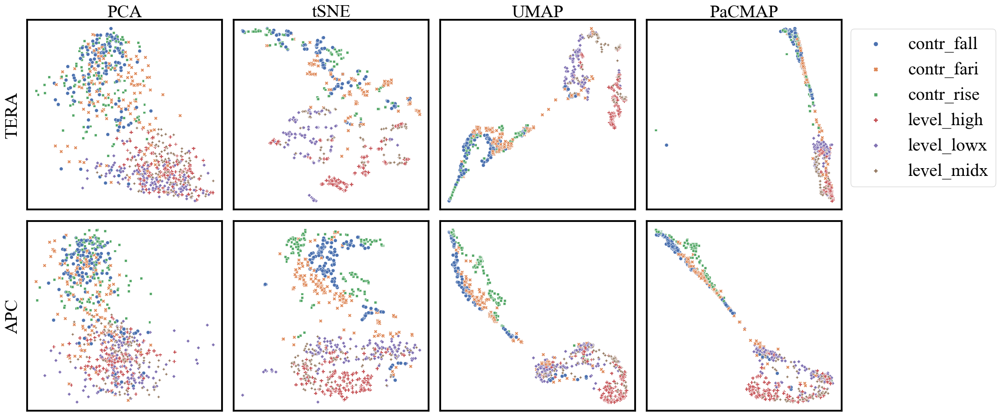

In [149]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Label'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(generative_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/generative_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/generative_{label}_dimred.svg')

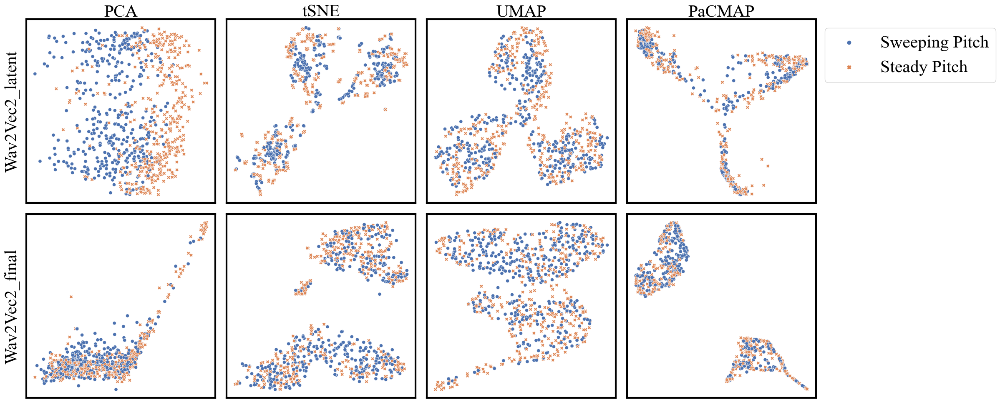

In [152]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Binary_Label'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(wav2vec2_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    df['Binary_Label'] = df['Label'].apply(lambda x: x[:5])
    df['Binary_Label'] = df['Binary_Label'].str.replace('contr', 'Sweeping Pitch')
    df['Binary_Label'] = df['Binary_Label'].str.replace('level', 'Steady Pitch')
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    if model_name == 'Wav2Vec2':
        model_name += '_final'
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/wav2vec2_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/wav2vec2_{label}_dimred.svg')

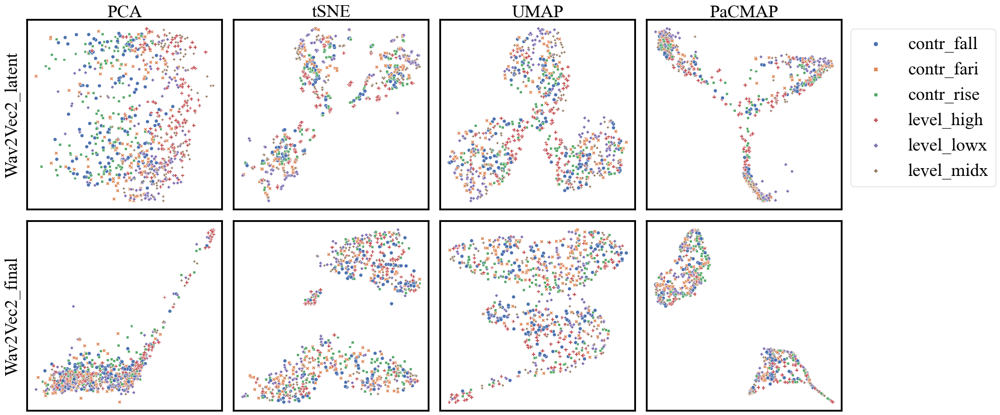

In [153]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Label'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(wav2vec2_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    if model_name == 'Wav2Vec2':
        model_name += '_final'
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/wav2vec2_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/wav2vec2_{label}_dimred.svg')

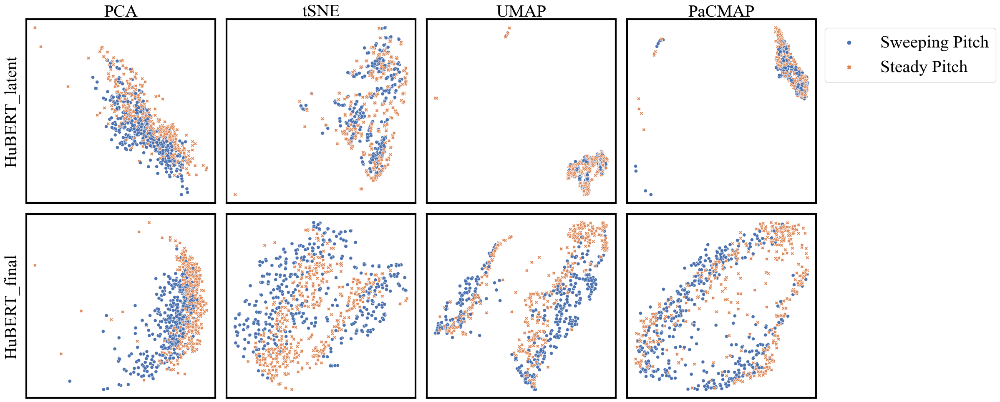

In [154]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Binary_Label'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(hubert_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    df['Binary_Label'] = df['Label'].apply(lambda x: x[:5])
    df['Binary_Label'] = df['Binary_Label'].str.replace('contr', 'Sweeping Pitch')
    df['Binary_Label'] = df['Binary_Label'].str.replace('level', 'Steady Pitch')
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    if model_name == 'HuBERT':
        model_name += '_final'
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/hubert_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/hubert_{label}_dimred.svg')

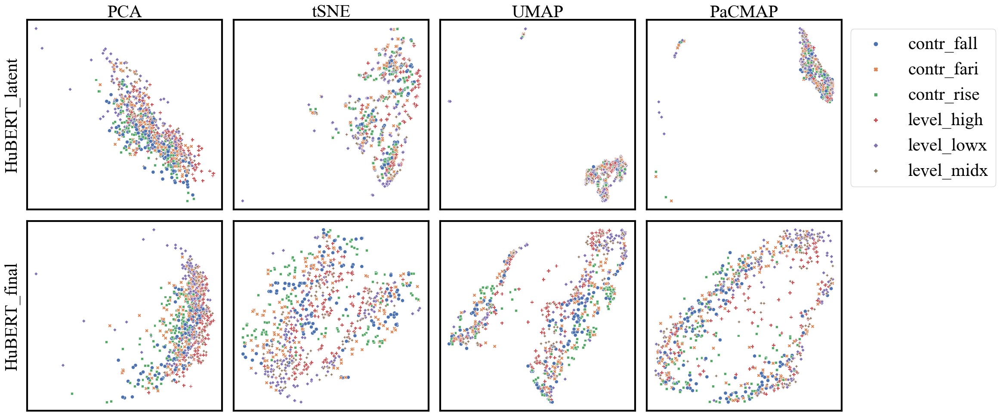

In [155]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Label'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(hubert_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    if model_name == 'HuBERT':
        model_name += '_final'
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/hubert_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/hubert_{label}_dimred.svg')

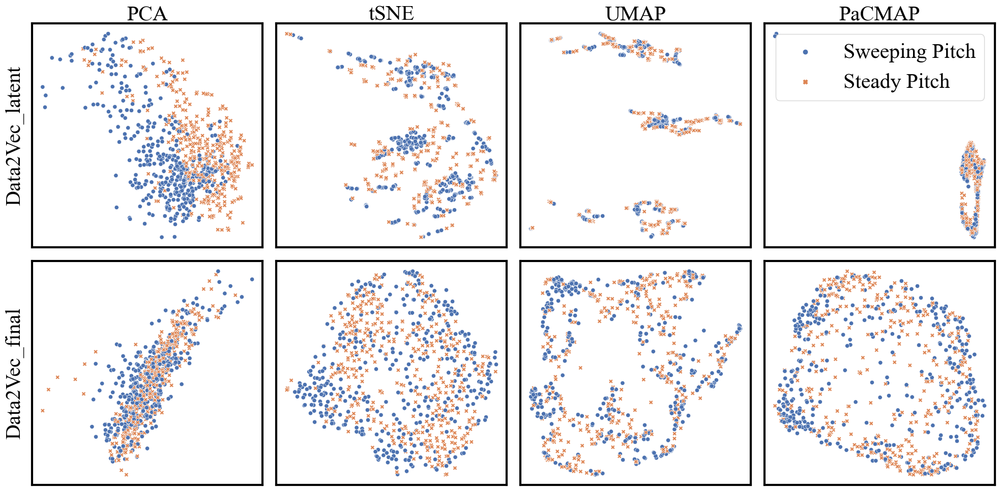

In [156]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Binary_Label'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(data2vec_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    df['Binary_Label'] = df['Label'].apply(lambda x: x[:5])
    df['Binary_Label'] = df['Binary_Label'].str.replace('contr', 'Sweeping Pitch')
    df['Binary_Label'] = df['Binary_Label'].str.replace('level', 'Steady Pitch')
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    if model_name == 'Data2Vec':
        model_name += '_final'
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/data2vec_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/data2vec_{label}_dimred.svg')

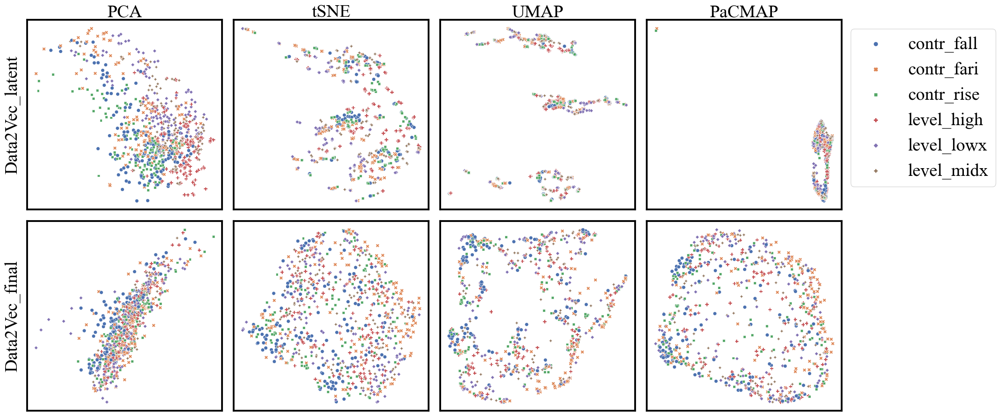

In [ ]:
fig, ax = plt.subplots(2, 4, figsize=(20, 10))
optimize = 'Global'
label = 'Label'
reducer_names = ['PCA', 'tSNE', 'UMAP', 'PaCMAP']
for i, model_name in enumerate(data2vec_models):
    df = pd.read_csv(f'../{exp_config.dataset_name}/{model_name}/dim_reduction.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': '', 'Unnamed: 20_level_1': '', 'Unnamed: 20_level_2': '',
                       'Unnamed: 21_level_1': '', 'Unnamed: 21_level_2': '',},inplace=True)
    for j, name in enumerate(reducer_names):
        ax[0,j].set_title(f'{name}', fontsize=30)
        visualize_embeddings(df.loc[df.Label!='train'], label, metrics=[], axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    if model_name == 'Data2Vec':
        model_name += '_final'
    ax[i, 0].set_ylabel(model_name, fontsize=30)
plt.tight_layout()
ax[0,j].legend(bbox_to_anchor=(1, 1), fontsize=30)
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/data2vec_{label}_dimred.png')
plt.savefig(f'../{exp_config.dataset_name}/dim_red_plots/data2vec_{label}_dimred.svg')